<img align="right" src="https://ds-cs-images.s3.ap-northeast-2.amazonaws.com/Codestates_Fulllogo_Color.png" width=100>

## *DATA SCIENCE / SECTION 2 / SPRINT 3 / NOTE 1*

# 📝 Assignment
---
# Choose your ML problems

이번 스프린트에서는 포트폴리오 프로젝트를 위해 수강생 각자가 정한 데이터셋을 사용하여 과제를 수행합니다. 프로젝트를 위한 데이터를 최종 선택하기 전에 여러 가능한 데이터세트를 살펴보고 간단한 모델까지 학습해 보는 것을 추천드립니다.

# 설치 파일
파일 실행 중 오류가 발생 한다면, 이 부분의 주석을 제거 하고 실행 후 런타임 재시작을 해주세요 !

In [1]:
# !pip install https://github.com/pandas-profiling/pandas-profiling/archive/master.zip
# !pip install category_encoders

# 데이터 불러오기
Lol의 챔피언 픽에 따른 승 패 예측 모형을 만들어 보겠습니다.

In [2]:
import pandas as pd

df = pd.read_csv('Lol_matchs.csv', index_col = 0)
team1 = df.iloc[:, :150]
team2 = df.iloc[:, 150:300]
result = df.iloc[:, 300:]

# 데이터 프로파일링

In [3]:
from pandas_profiling import ProfileReport
profile = ProfileReport(df, title="Pandas Profiling Report", explorative=True)
profile

Summarize dataset:   0%|          | 0/315 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 데이터 프로파일링 결과
## Variable Types
- Categorical : 302 개

## Dataset 특징
- Feature 개수 : 302 개
- 샘플 개수 : 34678 개
- 결측치 개수 : 0 개
- Variables
두 팀 롤 챔피언 종류 150가지. 총 300, 팀1 승패, 팀2 승패 

승패 데이터 컬럼이 두개가 있는데 하나만 타겟으로 놓고 진행 하겠습니다.

# 결측치 확인

In [14]:
df.isnull().sum().sum()

0

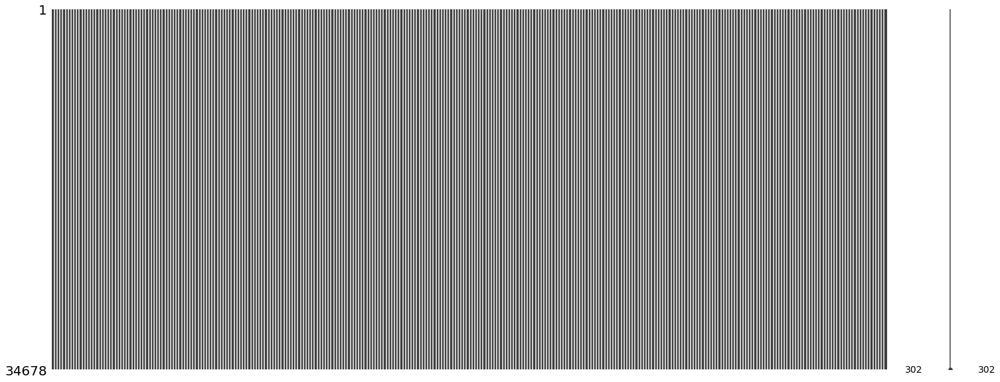

In [6]:
import missingno as msno
msno.matrix(df);

### 1) 타겟으로 사용할 특성을 선택합니다.
- **(객관식) 다음 중 설명이 올바른 항목을 선택하고 과제 제출폼에 제출하세요.**
    - 특성 3개를 사용해 가장 성능이 좋은 모델 A를 만들고 또 특성 5개를 사용해 최적의 모델 B를 학습하였습니다. 이때 모델 A에서 선택된 특성은 A1, A2, A3 입니다.
    1. 최적의 모델 B에는 특성 A1, A2, A3가 항상 선택됩니다.
    2. 최적의 모델 B 학습시 특성 A1, A2, A3는 전혀 사용되지 않습니다.
    3. 최적의 모델 B에 특성 A1, A2, A3가 선택될지 알 수 없습니다. <- 특성이 바뀌면 최적의 모델에 사용할 특성이 바뀜.

# 타겟으로 사용할 특성
Team1과 Team2의 챔피언들을 보고 어느팀이 승리 할지 예측 하기 위해서 Target은 team1이 승리 시 : 1 , 패배 시 : 0으로 두고 하겠습니다.

In [43]:
target = 'Team1'

In [16]:
result.head()

,Team1,Team2
0,1.0,0.0
1,1.0,0.0
2,1.0,0.0
3,1.0,0.0
4,1.0,0.0


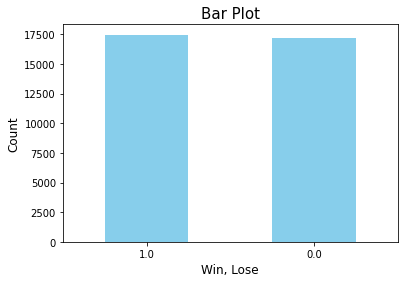

In [37]:
import matplotlib.pyplot as plt

df["Team1"].value_counts().plot(kind='bar', color = 'skyblue')
plt.title("Bar Plot", fontsize=15)
plt.ylabel("Count", fontsize=12)
plt.xlabel("Win, Lose", fontsize=12)
plt.xticks(rotation=0)
plt.show()

### 2) 풀고자 하는 문제가 분류/회귀 문제인지 정합니다.
- **(객관식) 다음 설명 중 가장 틀린 항목을 선택하고 과제 제출폼에 제출하세요.**
    1. 특정한 종목의 다음날 주식 종가를 예측하는 문제는 Supervised Learning 문제이다.
    2. 다음날 KOSPI 지수가 증가할지 감소할지 예측하는 문제는 Classification 문제이다.
    3. 축구 경기 도중에 승패를 예측하는 모델을 만들기 위해서는 실시간 통계 정보와 경기마다 승패 데이터가 필요하다.
    4. 이번 시즌 토트넘 선수들의 개인 통계 데이터(슛, 도움, ...)를 사용해서 다음 토트넘 경기의 승패를 예측할 수 있다. <- 확정적으로 말할 수 없음.
   

# 분류 문제
승, 패로 분류 되기 때문에 분류로 정하고 진행 하겠습니다.

### 3) 타겟의 분포를 분석하고 사용할 평가지표를 선택합니다. 평가지표를 선택한 이유를 설명하세요.
- 분류: 클래스가 몇 개인지? 클래스 비율이 어떤지(balance or imbalance)
- 회귀: 타겟 분포가 right-skewed 인지? log-transform을 사용할 것인지?
- 분류: 다수 클래스(majority class) 비율이 50%~70% 인 경우 정확도(accuracy)만 사용해도 무방합니다. 하지만 범위를 넘어설 경우 정확도만을 사용해서는 모델을 잘못 이해할 수 있습니다. 어떤 평가지표를 사용해야 할까요?
- 회귀: MAE, RMSE, R^2 등을 사용할 수 있습니다.
- **(객관식) 같은 데이터로 스팸을 예측하는 모델 A와 B를 만들었습니다. 다음 설명 중 가장 올바른 항목을 선택하고 과제 제출폼에 제출하세요.**
    1. A의 재현율은 80%이고 B의 재현율은 60%일 때 A가 더 좋은 모델이다.
    2. A의 정밀도는 80%이고 B의 정밀도는 60%일 때 A가 더 좋은 모델이다.
    3. A는 B보다 정밀도는 높지만 재현율은 낮다. A가 더 좋은 모델이다.
    4. A는 B보다 재현율은 높지만, 정밀도는 낮다. A가 더 좋은 모델이다.
    5. A는 B보다 정밀도, 재현율 모두 높다. A가 더 좋은 모델이다. <- 정밀도, 재현율 높을수록 좋은 모형이다.

# 타겟의 분포


In [18]:
df.Team1.value_counts()

1.0    17466
0.0    17212
Name: Team1, dtype: int64

1이 0보다 많음. 기준 1로 두고 기준모델 테스트를 진행 해보겠습니다.

In [38]:
# mode(): Return the highest frequency value in a Series.
major = df.Team1.mode()[0]

# 타겟 샘플 수 만큼 0이 담긴 리스트를 만듭니다. 기준모델로 예측
y_pred = [major] * len(df.Team1)

# 최다 클래스의 빈도가 정확도가 됩니다.
from sklearn.metrics import accuracy_score
print("training accuracy: ", accuracy_score(df.Team1, y_pred))

training accuracy:  0.5036622642597612


평가지표는 정확도만 사용 해보도록 해보겠습니다.

## 🔥 도전과제

### 4) 데이터를 훈련/검증/테스트 데이터로 나누고 전처리를 수행합니다. 그리고 간단한 모델을 사용해서 학습을 수행합니다.
- 이상치(outliers)가 있다면 어떻게 처리할 것인지 설명합니다.
- 무작위로 or 시간에 따라 데이터를 나눌 것인지 설명합니다.
- 모델 학습 결과를 리포팅 합니다.
- 정보 누수(leakage)가 있는지 확인해 봅니다.

# 훈련, 검증, 테스트 데이터로 분리
데이터가 150개의 챔피언 중 각 팀에 그 챔피언이 있을 경우 1, 없을경우 0 으로 이진 분리 되어있기 때문에 이상치는 따로 없다.


In [40]:
df.iloc[:,:300].head()

,Aatrox,Ahri,Akali,Alistar,Amumu,Anivia,Annie,Aphelios,Ashe,Aurelion Sol,Azir,Bard,Blitzcrank,Brand,Braum,Caitlyn,Camille,Cassiopeia,Cho'Gath,Corki,Darius,Diana,Dr. Mundo,Draven,Ekko,Elise,Evelynn,Ezreal,Fiddlesticks,Fiora,Fizz,Galio,Gangplank,Garen,Gnar,Gragas,Graves,Hecarim,Heimerdinger,Illaoi,...,Soraka.1,Swain.1,Sylas.1,Syndra.1,Tahm Kench.1,Taliyah.1,Talon.1,Taric.1,Teemo.1,Thresh.1,Tristana.1,Trundle.1,Tryndamere.1,Twisted Fate.1,Twitch.1,Udyr.1,Urgot.1,Varus.1,Vayne.1,Veigar.1,Vel'Koz.1,Vi.1,Viktor.1,Vladimir.1,Volibear.1,Warwick.1,Wukong.1,Xayah.1,Xerath.1,Xin Zhao.1,Yasuo.1,Yone.1,Yorick.1,Yuumi.1,Zac.1,Zed.1,Ziggs.1,Zilean.1,Zoe.1,Zyra.1
0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


훈련과 테스트로 80 : 20 으로 나누고, 훈련 데이터를 훈련과 검증 80:20으로 분리 하도록 하겠습니다.

In [46]:
from sklearn.model_selection import train_test_split

train_data, test_data = train_test_split(df.iloc[:, :301], train_size=0.80, test_size=0.20, 
                                        stratify=df.Team1, random_state=2)

train_data, val_data = train_test_split(train_data, train_size=0.80, test_size=0.20, 
                                        stratify=train_data.Team1, random_state=2)

X_train = train_data.drop(target, axis = 1)
y_train = train_data[target]

X_val = val_data.drop(target, axis = 1)
y_val = val_data[target]

X_test = test_data.drop(target, axis = 1)
y_test = test_data[target]

X_train.shape, X_val.shape, X_test.shape

((22193, 300), (5549, 300), (6936, 300))

pipeline을 이용해서 TargetEncoder, RandomForestRegressor을 사용 하였고, RandomizedSearchCV을 사용 하여 최적화 하였습니다.

In [50]:
from sklearn.pipeline import make_pipeline
from category_encoders import TargetEncoder
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from scipy.stats import randint, uniform
import numpy as np

pipe = make_pipeline(
    TargetEncoder(), 
    RandomForestRegressor(random_state=2)
)

dists = {
    'targetencoder__smoothing': [2.,20.,50.,60.,100.,500.,1000.], # int로 넣으면 error(bug)
    'targetencoder__min_samples_leaf': randint(1, 10),
    'randomforestregressor__n_estimators': randint(50, 500), 
    'randomforestregressor__max_depth': [5, 10, 15, 20, None], 
    'randomforestregressor__max_features': uniform(0, 1) # max_features
}

clf = RandomizedSearchCV(
    pipe, 
    param_distributions=dists, 
    n_iter=5, 
    cv=3, 
    scoring='neg_mean_absolute_error',  
    verbose=1,
    n_jobs=-1
)

clf.fit(X_train, y_train);

Fitting 3 folds for each of 5 candidates, totalling 15 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  15 out of  15 | elapsed:  2.6min finished
/usr/local/lib/python3.7/dist-packages/category_encoders/utils.py:21: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
  elif pd.api.types.is_categorical(cols):


In [51]:
pd.DataFrame(clf.cv_results_).sort_values(by='rank_test_score').T

,2,3,4,1,0
mean_fit_time,30.5712,30.6872,24.4157,2.98451,7.53061
std_fit_time,0.161071,0.247601,5.06064,0.0121189,0.0317557
mean_score_time,0.222075,0.279043,0.115258,0.0415579,0.120941
std_score_time,0.0112676,0.00865107,0.0260759,0.00127086,0.00200584
param_randomforestregressor__max_depth,15,15,5,5,5
param_randomforestregressor__max_features,0.563969,0.43036,0.722837,0.275347,0.234427
param_randomforestregressor__n_estimators,140,180,312,81,234
param_targetencoder__min_samples_leaf,9,1,1,2,9
param_targetencoder__smoothing,60,2,500,2,100
params,"{'randomforestregressor__max_depth': 15, 'rand...","{'randomforestregressor__max_depth': 15, 'rand...","{'randomforestregressor__max_depth': 5, 'rando...","{'randomforestregressor__max_depth': 5, 'rando...","{'randomforestregressor__max_depth': 5, 'rando..."


In [52]:
# 만들어진 모델에서 가장 성능이 좋은 모델을 불러옵니다.
pipe = clf.best_estimator_
y_pred = pipe.predict(X_test)
print('훈련 모델 트레이닝 점수', pipe.score(X_train, y_train))
print('검증 모델 트레이닝 점수', pipe.score(X_val, y_val))
print('테스트 모델 트레이닝 점수', pipe.score(X_test, y_test))

훈련 모델 트레이닝 점수 0.18344206237129934
검증 모델 트레이닝 점수 0.09511917050311204
테스트 모델 트레이닝 점수 0.09395022425541621


?!?!?!?!!!!!